# TODO

    -> #later function to run sextractor from jupyter 
    -> #later function to plot squares in an image centered in a given RA and DEC (params: size and color of point)
    -> #later function to load and preprocess correctly the output of sextractor
    -> function to select only objects within range (+- 0.01 RA and DEC) from positions of known LSBs
    -> function to plot these selected objects over the greyscale pic

# Imports

In [7]:
import pandas as pd
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
import glob
from config import IMAGES_DIR

In [71]:
files = glob.glob(IMAGES_DIR+"*.npz")
data = [np.load(file)['img'] for file in files][2]

In [251]:
img = np.load('data/images/SPLUS-s28s34_rgb.npz')['img']

In [323]:
mask = get_mask(img[:,:,0],pixel_threshold=250)

In [379]:
LSBs_coords = pd.read_csv("data/LSBs_coordinates/SPLUS-s28s34.csv", usecols = ["Status","RA","DEC"])
detected_original,detected_masked = [pd.read_csv(f'data/results/{f}.csv', usecols=["RA","DEC"]) for f in ["original","masked"]]


In [372]:
def filter_region(coords:pd.DataFrame, 
                  lsb:pd.DataFrame, 
                  threshold:float = 0.01)->pd.DataFrame:
    """
    returns all objects in coords that are within a certain threshold from the objects in lsb
    """
    
    lsb_coords = zip(lsb.RA.to_list(),lsb.DEC.to_list())
    filter_conditions = [f"({RA-0.01} <= RA <= {RA+0.01} and {DEC-0.01} <= DEC <= {DEC+0.01})" for RA,DEC in lsb_coords]
    filter_query = " or ".join(filter_conditions)
    
    return coords.query(filter_query)

In [373]:
orig_detected_filtered = filter_region(detected_original,LSBs_coords)
mask_detected_filtered = filter_region(detected_masked,LSBs_coords)

In [366]:
plt.imsave('data/results/s28s34.png',arr=img[:,:,0] , cmap='gray_r')

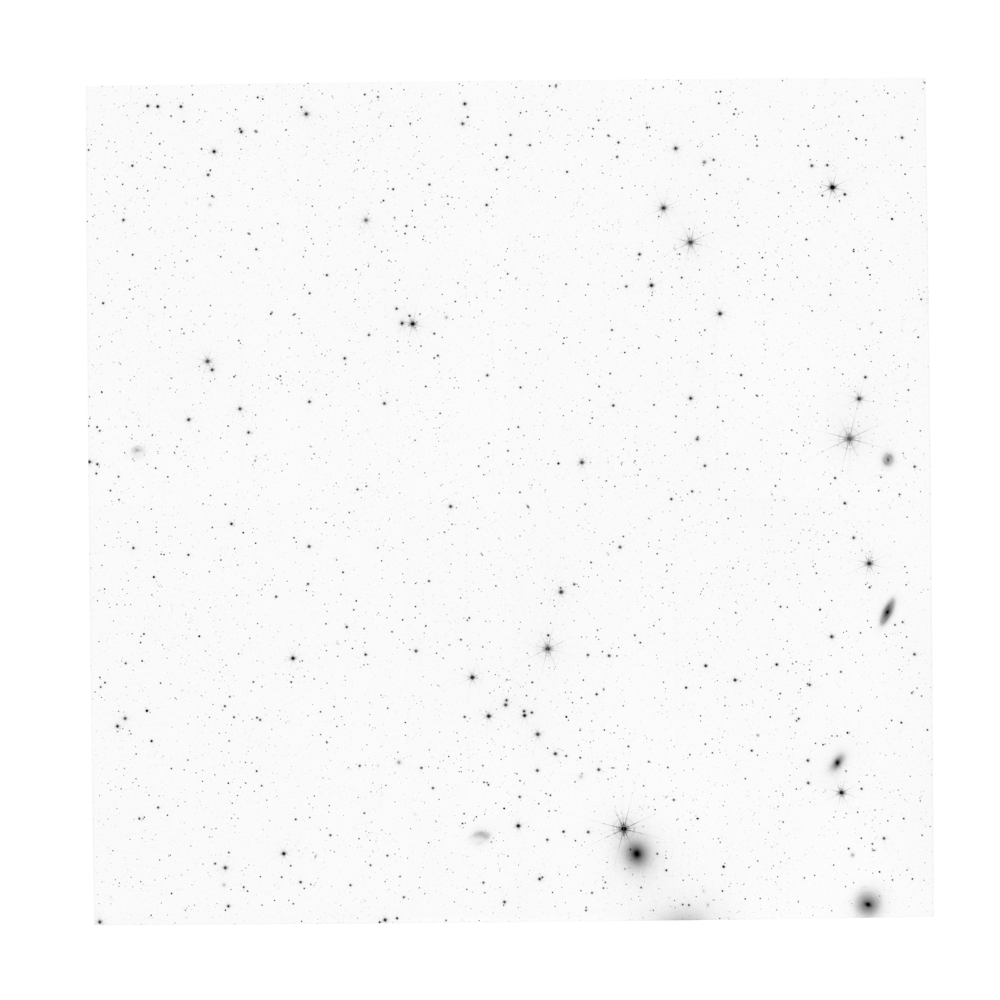

In [375]:
w = 11000/192

fig = plt.figure(frameon=False)
fig.set_size_inches(w,w)
ax = plt.Axes(fig, [0., 0., 1., 1.])
ax.set_axis_off()
fig.add_axes(ax)
for row in orig_detected_filtered.values.tolist():
    RA,DEC = row
    position = coord2pix(wcs_obj,[RA, DEC])
    plt.scatter(position[0], position[1], marker = "+", c= "r", s = 1);
plt.imshow(img[:,:,0] , cmap='gray_r');
fig.savefig('data/results/original_detected.png', dpi=192)

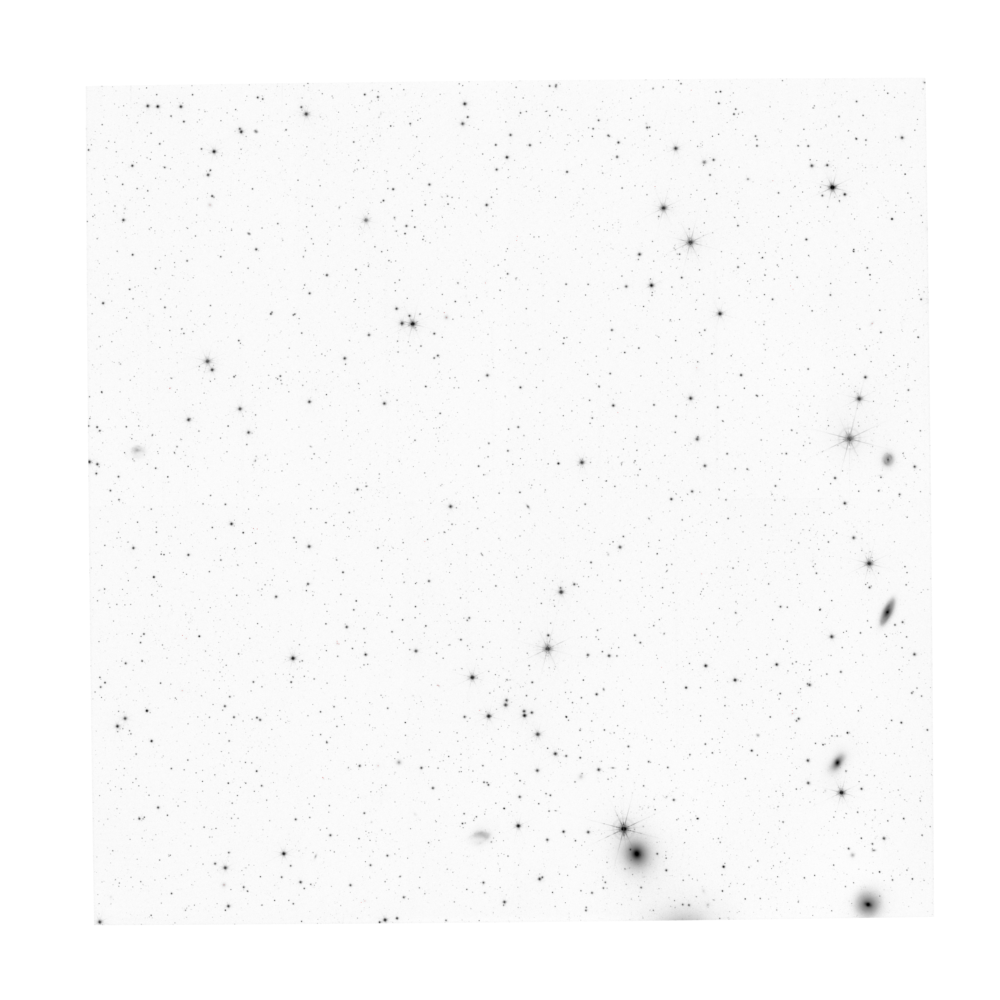

In [376]:
w = 11000/192

fig = plt.figure(frameon=False)
fig.set_size_inches(w,w)
ax = plt.Axes(fig, [0., 0., 1., 1.])
ax.set_axis_off()
fig.add_axes(ax)
for row in mask_detected_filtered.values.tolist():
    RA,DEC = row
    position = coord2pix(wcs_obj,[RA, DEC])
    plt.scatter(position[0], position[1], marker = "+", c= "r", s = 1);
plt.imshow(img[:,:,0] , cmap='gray_r');
fig.savefig('data/results/masked_detected.png', dpi=192)

In [377]:
marked_original = plt.imread('data/results/original_detected.png')
marked_masked = plt.imread('data/results/masked_detected.png')

In [317]:
img.shape, marked_original.shape, marked_masked.shape

((11000, 11000, 3), (11000, 11000, 4), (11000, 11000, 4))

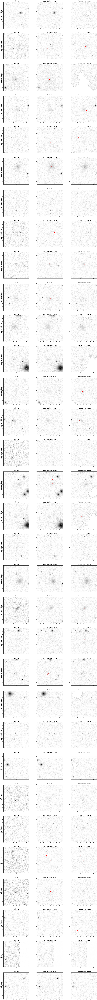

In [378]:
fig,ax = plt.subplots(32,3,figsize=(30,10*32))
masked_masked = marked_masked*np.dstack([mask]*4)
for i,row in LSBs_coords.iterrows():
    RA,DEC,STATUS = row
    ax[i,0].imshow(getcutout(wcs_obj, img, [RA,DEC], size=100)[:,:,0],cmap='gray_r')
    ax[i,0].set_ylabel(STATUS, fontsize=25)
    ax[i,0].set_title("original", fontsize=25)
    ax[i,1].imshow(getcutout(wcs_obj, marked_original, [RA,DEC], size=100))
    ax[i,1].set_title("detected w/o mask", fontsize=25)
    ax[i,2].imshow(getcutout(wcs_obj, masked_masked, [RA,DEC], size=100))
    ax[i,2].set_title("detected with mask", fontsize=25)

fig.savefig('data/results/sumary_sextractor_minarea40.png')

In [205]:
for row in LSBs_coords.iterrows():
    RA,DEC,*_ = row[1]
    print(RA,DEC)

55.15724475 -36.12206287
55.282958799999996 -35.51490145
54.57704461 -35.53314224
55.33924496 -35.94942849
55.65384514 -35.95821446
55.57369745 -35.53508508
54.67396863 -36.72764777
54.43243818 -36.7261937
55.36764068 -35.72083239
55.25345006 -35.74442243
55.60671542 -36.68573579
55.03841236 -35.8364934
55.6594545 -35.86877298
55.1246486 -35.87644743
54.95787991 -36.63400525
54.39505641 -35.82840866
55.039483600000004 -35.83726128
55.07148492 -36.53471562
55.11704462 -36.5018145
54.22101574 -36.48413002
54.58886843 -36.41110859
55.68815831 -36.37895301
54.75331639 -36.33826403
55.51338767 -36.13959361
54.60513383 -36.89015933
55.02931567 -36.55989569
54.906948899999996 -36.55310976
54.38493552 -36.54482525
54.57997274 -36.06583223
54.655182999999994 -35.91720684
54.10520922 -35.70303306
55.2788723 -35.69009573


In [198]:
for row in detected_original.iterrows():
    RA,DEC = row[1]
    print(RA,DEC)

44.6772591 -36.884445899999996
44.105250899999994 -36.8917149
44.895305500000006 -36.8891196
44.6236098 -36.8977602
44.404506700000006 -36.8967375
44.39575010000001 -36.899528600000004
44.881730299999994 -36.8906935
44.3138047 -36.898262700000004
45.0859339 -36.8927659
45.40833000000001 -36.8411639
44.179590399999995 -36.8998124
44.692263399999995 -36.899207399999995
44.3080535 -36.8989536
44.6183579 -36.8924488
44.1052147 -36.8985097
44.2425041 -36.900002
44.6447927 -36.899507899999996
44.500827 -36.89994779999999
44.4090553 -36.9002836
44.882376199999996 -36.8882208
44.744856999999996 -36.898808
44.9579887 -36.8981525
44.812206599999996 -36.897762799999995
44.5785022 -36.895982700000005
44.5148223 -36.896445
44.6286221 -36.8978325
45.4050333 -36.893017
44.831431200000004 -36.8976209
44.46750479999999 -36.896014
45.074306299999996 -36.8589907
45.06538520000001 -36.896224700000005
44.7277583 -36.8974349
44.3163772 -36.8921496
44.919466799999995 -36.8970803
44.8760351 -36.8950229
44.748

45.7471667 -36.7917799
44.5740017 -36.79432
45.36878589999999 -36.7912282
45.7729628 -36.7924487
44.2297675 -36.7873242
44.8539809 -36.7933178
45.2735816 -36.7946456
44.273702 -36.793525700000004
45.2984174 -36.7954261
45.833095400000005 -36.7927886
45.86013739999999 -36.786971799999996
44.978114500000004 -36.7922574
45.86608470000001 -36.7782164
44.8586686 -36.7903255
45.5506255 -36.7919729
45.34183960000001 -36.7940801
44.4126755 -36.7934365
44.5772368 -36.7910944
45.8681885 -36.7866662
45.5874682 -36.791293599999996
44.9178198 -36.7939174
45.628431000000006 -36.7813777
44.30080079999999 -36.7162295
45.076228 -36.7916032
44.2031286 -36.7914003
45.6467157 -36.7923324
45.1642251 -36.792275
45.02326360000001 -36.7927398
45.3336765 -36.7927129
44.583884600000005 -36.786682299999995
44.985398200000006 -36.768939200000005
44.24636949999999 -36.78973870000001
44.2776498 -36.788063
45.2585795 -36.7915664
45.0465051 -36.7913792
44.482354799999996 -36.7886065
45.5045911 -36.7873946
45.4367299 

45.0179918 -36.7016358
44.2406132 -36.7086775
45.147225 -36.7092064
45.2907407 -36.7107776
44.50117579999999 -36.7072618
45.6878203 -36.7074627
45.6151594 -36.7065953
44.8221593 -36.7078001
45.2450586 -36.6956797
44.77680229999999 -36.708027
45.5953058 -36.7075701
45.204530299999995 -36.7098876
44.78728520000001 -36.7086568
45.1218689 -36.7018775
44.3215748 -36.7086748
45.0147672 -36.7093471
44.817972899999994 -36.7082667
44.5981721 -36.7057756
44.6627456 -36.7085547
45.1251905 -36.7070086
45.5667238 -36.7033479
45.8229036 -36.705039299999996
45.100796200000005 -36.70131729999999
44.8833616 -36.7014701
45.1118239 -36.7067471
44.1972512 -36.7049277
45.006026 -36.706563
45.22946579999999 -36.70578629999999
45.028122700000004 -36.6885129
45.447385 -36.7053445
44.2189882 -36.704184600000005
44.6250515 -36.7034505
44.8661613 -36.7060391
45.4060052 -36.7054324
44.96023979999999 -36.706892100000005
44.293707999999995 -36.704229600000005
45.570711800000005 -36.7042317
44.569348700000006 -36.69

45.449810600000006 -36.598825500000004
44.682095999999994 -36.552526
44.1811074 -36.5911909
44.206843500000005 -36.5969047
45.0148801 -36.6009878
44.774322600000005 -36.600250700000004
45.24054520000001 -36.5998723
44.534717099999995 -36.599722899999996
44.62299010000001 -36.596461
45.3505035 -36.5996211
44.955482200000006 -36.5999529
45.13142760000001 -36.5994011
44.212635600000006 -36.5962186
44.677128599999996 -36.5934236
44.89827760000001 -36.5974372
45.8229873 -36.5952422
44.738181700000005 -36.5993894
45.5054797 -36.5969504
45.6464713 -36.595884000000005
45.334320999999996 -36.5988979
44.577646400000006 -36.5987585
45.0710952 -36.595490999999996
45.2190753 -36.593988
45.7153253 -36.5931872
45.5887953 -36.596365899999995
44.5840436 -36.5973579
44.6047879 -36.5966799
44.3054709 -36.5950251
44.638250899999996 -36.5962466
44.7408895 -36.5970521
45.12882760000001 -36.5965616
45.84437420000001 -36.591415600000005
45.6835801 -36.5893955
44.5001187 -36.582763899999996
44.140120499999995 

45.667531499999996 -36.4775742
44.2523573 -36.4848252
44.9869951 -36.4858387
45.61718979999999 -36.4842595
44.2014103 -36.471110700000004
44.940878000000005 -36.4854275
44.2960356 -36.48585429999999
45.31076329999999 -36.4859679
45.554923200000005 -36.4843911
45.299717 -36.482318
44.79975079999999 -36.487263399999996
44.9435764 -36.4861051
44.157718599999995 -36.483214600000004
44.7131655 -36.4855369
45.1378542 -36.4715421
45.7589738 -36.4826391
44.2455015 -36.4770654
45.0040985 -36.4858892
44.8393519 -36.4850438
45.737984 -36.482096000000006
45.72402950000001 -36.480785499999996
45.8320489 -36.4820885
45.728964899999994 -36.483339799999996
45.131263600000004 -36.484756700000005
45.27193520000001 -36.4841296
45.26848470000001 -36.4839535
45.16344 -36.4834741
45.059096200000006 -36.483414
44.6913382 -36.4832552
45.6335889 -36.4815411
45.665949499999996 -36.4785365
45.3943784 -36.4828522
44.15678199999999 -36.4807068
45.1155281 -36.4828189
45.259147999999996 -36.478905299999994
45.204324

44.312861899999994 -36.3823528
45.380364 -36.384024200000006
44.54486039999999 -36.383129700000005
44.1476976 -36.381313899999995
45.554759499999996 -36.3822464
44.4830319 -36.3833105
44.7923639 -36.3813667
45.563764 -36.382301299999995
45.25156170000001 -36.3817782
45.1207108 -36.3828683
44.2690512 -36.3807921
45.316601 -36.3828557
45.4851458 -36.378471399999995
44.80576729999999 -36.383608200000005
45.544443900000005 -36.34348320000001
44.216127799999995 -36.378217299999996
44.9511083 -36.3835794
45.691074300000004 -36.377796200000006
45.3222968 -36.3820644
44.4114402 -36.381314399999994
44.361796999999996 -36.3803557
45.503690299999995 -36.3785889
45.8340752 -36.3703787
45.3854787 -36.376507200000006
45.146053 -36.380669899999994
45.3876923 -36.3818554
45.3991179 -36.3559923
45.692203799999994 -36.377017200000004
45.716789399999996 -36.3779907
45.687245700000005 -36.3797524
44.5944399 -36.3814787
45.1884121 -36.3821049
45.8369739 -36.378878799999995
45.6182904 -36.379924
45.7598289 

44.608806900000005 -36.2772864
44.8201365 -36.2633904
45.571450600000006 -36.271085299999996
44.1335976 -36.2743125
45.38866379999999 -36.268215600000005
44.214418099999996 -36.2741667
45.5066509 -36.2760965
44.3239216 -36.2719944
45.8391645 -36.2730477
45.191520999999995 -36.27675120000001
45.5996096 -36.27344420000001
45.7159034 -36.270554
45.793414500000004 -36.2717359
44.6073162 -36.2740419
44.4102174 -36.26789829999999
44.325831900000004 -36.2705339
44.688061899999994 -36.2742695
45.677986700000005 -36.2735602
45.35469870000001 -36.27223
45.661791 -36.2708674
45.4904392 -36.265506
45.7851074 -36.2682395
44.225087800000004 -36.268406799999994
45.724101600000004 -36.2706325
45.1106074 -36.268674299999994
45.8338881 -36.270444899999994
45.5703409 -36.271077899999995
44.9999582 -36.2745375
45.7146593 -36.267304700000004
45.135112199999995 -36.273238
45.4369936 -36.272549299999994
44.5716907 -36.2480201
45.27159770000001 -36.2731309
45.2577711 -36.271496899999995
44.222378500000005 -36

44.68494870000001 -36.1719313
44.7852608 -36.172039500000004
44.6591446 -36.17044
45.560793999999994 -36.1494638
44.3121277 -36.1647467
45.752491299999996 -36.1699592
45.5309676 -36.1681441
44.9792865 -36.1707045
44.5379767 -36.1701134
44.7908363 -36.1691624
45.6727645 -36.1682526
44.9391311 -36.168122600000004
44.2479588 -36.15225039999999
45.4211152 -36.1710111
45.0118505 -36.1701097
45.238026899999994 -36.1711209
44.68870210000001 -36.1594092
45.48052579999999 -36.1689523
45.2632578 -36.1698244
44.194672499999996 -36.1680216
44.5235819 -36.159000299999995
45.39569920000001 -36.1697792
45.4253093 -36.1662915
44.496815000000005 -36.163298299999994
44.35606310000001 -36.1653891
45.672435899999996 -36.1669777
44.307018500000005 -36.1669374
45.34360770000001 -36.167654299999995
45.347269999999995 -36.1669757
45.4737328 -36.166982899999994
45.4759687 -36.1663139
44.1214836 -36.1624248
44.60394599999999 -36.162648100000006
45.2261576 -36.1673374
44.4320211 -36.1648532
45.70197629999999 -36

44.210457 -36.065127000000004
44.796701600000006 -36.0642495
44.707325 -36.070541600000006
45.7804452 -36.066061600000005
45.6606877 -36.0670703
44.2557145 -36.0672268
44.9694076 -36.0695032
45.715255799999994 -36.0682779
45.091353500000004 -36.070401600000004
45.14822320000001 -36.05427
45.7124662 -36.0680018
45.8397821 -36.0671565
45.203035 -36.0662523
44.9654293 -36.060885999999996
45.012476 -36.0650043
44.380107900000006 -36.0637638
45.45168489999999 -36.067433799999996
44.6183731 -36.0692536
45.484055500000004 -36.066857399999996
44.2196603 -36.064062
44.5796906 -36.06589879999999
45.7767948 -36.0644381
44.5520863 -36.0663667
44.25243270000001 -36.0643184
44.3239793 -36.0647629
45.828114799999994 -36.0645299
45.58375 -36.066478000000004
45.1460119 -36.0666814
45.4005165 -36.0488279
44.24097879999999 -36.0637816
44.81535649999999 -36.0615388
44.953962100000005 -36.064327899999995
45.843154399999996 -36.0636602
44.2358086 -36.0625372
44.7859364 -36.0659294
44.441774699999996 -36.064

45.13482710000001 -35.9643521
44.830223700000005 -35.9601114
44.1857536 -35.963094299999995
45.043271600000004 -35.964625399999996
44.7999998 -35.9601251
45.5212211 -35.9566487
45.276065 -35.9648343
45.719991 -35.9606981
44.17221510000001 -35.9610384
44.215820900000004 -35.9627051
45.295706 -35.963074600000006
44.3239547 -35.9621112
45.6615395 -35.9609722
44.707689 -35.9501899
45.775739 -35.9610635
44.81982270000001 -35.959627600000005
45.37914 -35.9625526
45.50651559999999 -35.9626263
45.1127626 -35.961799299999996
44.274156299999994 -35.9580968
45.7487698 -35.9483042
44.5235397 -35.9596
44.7945571 -35.9557758
45.3241517 -35.9616225
45.8045115 -35.957620299999995
44.3579512 -35.9586816
45.1571988 -35.9609741
44.40179200000001 -35.951615000000004
45.5826661 -35.958871200000004
44.6880543 -35.960615600000004
44.4413796 -35.9573439
45.817035700000005 -35.9548813
45.4718366 -35.9587779
45.280817500000005 -35.9583799
45.2234451 -35.95933370000001
45.3222655 -35.953244500000004
45.2814981 -

45.613688100000005 -35.8894263
44.12746310000001 -35.887829700000005
45.8309495 -35.8728444
45.012772999999996 -35.890074
44.4979514 -35.889970899999994
44.976553700000004 -35.8892543
44.5576086 -35.888813299999995
45.3218264 -35.8866729
44.859931 -35.8876308
44.730562600000006 -35.889340399999995
45.0235644 -35.8266065
44.369496999999996 -35.8879657
45.4620438 -35.88831
44.3695214 -35.88515220000001
44.6235707 -35.888609499999994
44.1910035 -35.8855016
44.163034200000006 -35.8856492
44.10089870000001 -35.8844079
44.476772399999994 -35.8877581
45.83068589999999 -35.885811100000005
45.595267099999994 -35.886128899999996
45.57347120000001 -35.8849256
45.359874 -35.881710600000005
44.784249100000004 -35.8715883
45.7690897 -35.8857814
45.5508904 -35.8851009
44.988136100000006 -35.8855412
44.6867517 -35.8877075
44.281965799999995 -35.8851727
44.86375770000001 -35.88297360000001
45.0730443 -35.8858713
45.5839267 -35.8849402
45.1113057 -35.8874932
44.35427320000001 -35.883478600000004
44.4324

44.2280322 -35.78748770000001
44.34435260000001 -35.7789495
45.309830299999994 -35.7895708
45.360398499999995 -35.783551200000005
44.794932200000005 -35.7887408
44.64427760000001 -35.784949100000006
44.48365329999999 -35.7857021
45.0876468 -35.784300200000004
44.82808589999999 -35.787074700000005
44.75078520000001 -35.7880326
45.181538399999994 -35.788078399999996
44.812423200000005 -35.7826696
44.54728370000001 -35.786909
45.193698100000006 -35.786804700000005
44.432642099999995 -35.7869448
45.2109843 -35.7888528
45.730119499999994 -35.786143599999996
44.6436373 -35.7875376
44.926025100000004 -35.7818092
45.67141289999999 -35.7824276
45.4697909 -35.7864484
45.7861556 -35.7828291
45.766122700000004 -35.783351
45.0777916 -35.7856701
44.468726100000005 -35.785315399999995
44.543526899999996 -35.7809683
44.805634899999994 -35.785037700000004
44.9338199 -35.7849924
45.705636399999996 -35.784515899999995
44.23613470000001 -35.7798236
45.014390399999996 -35.7837775
44.304565000000004 -35.783

44.243746400000006 -35.691598
45.2692118 -35.6932947
44.69703739999999 -35.6909901
44.128331 -35.6852118
44.663068599999995 -35.6927279
44.943290399999995 -35.6925924
45.126352100000005 -35.686230200000004
44.657454099999995 -35.6891398
45.4974808 -35.692258100000004
44.6608938 -35.691493
45.31913639999999 -35.69162
44.6434375 -35.6920589
44.462777100000004 -35.691658200000006
44.48759449999999 -35.6905197
45.247451399999996 -35.6918991
44.2672836 -35.6902951
44.490541099999994 -35.6908649
44.96213100000001 -35.6415242
44.127543200000005 -35.6805723
44.67984179999999 -35.6857206
44.412122499999995 -35.688297799999994
44.676704 -35.6907308
44.3117834 -35.6877471
44.975923 -35.691764500000005
44.424130299999995 -35.689716100000005
44.510335999999995 -35.687642499999995
44.546321299999995 -35.6898355
44.2006345 -35.686310799999994
45.6784863 -35.6849035
44.1029647 -35.6870523
44.6804162 -35.6878649
44.3707586 -35.685713799999995
45.484320499999995 -35.68406220000001
45.3997601 -35.6880703

45.5984512 -35.5902629
45.563940599999995 -35.5881745
44.4656399 -35.5813797
45.686350399999995 -35.5886418
44.40029820000001 -35.5856419
45.589466099999996 -35.5907276
45.2156566 -35.5925822
44.74203489999999 -35.5904388
45.02106929999999 -35.5912841
44.655491299999994 -35.586729999999996
45.3200017 -35.5896582
45.20650379999999 -35.5892756
44.6435766 -35.5890669
45.0547697 -35.5909136
44.843826799999995 -35.590072799999994
44.536656900000004 -35.5719578
44.332230599999995 -35.5892039
44.2269081 -35.5871231
45.0629068 -35.5903021
45.705625500000004 -35.581939
45.2685334 -35.5750768
44.4705993 -35.5864568
45.1915573 -35.587051
45.778335899999995 -35.5853119
45.112949 -35.5883598
44.77872239999999 -35.5886245
45.743009400000005 -35.58630170000001
44.665605299999996 -35.5897662
44.29704029999999 -35.5860131
45.157833600000004 -35.589226700000005
45.466967000000004 -35.5872042
45.752256 -35.5830484
45.365063 -35.586032200000005
45.6204323 -35.58685
44.591963 -35.5876401
44.6068514 -35.587

44.5087856 -35.4943592
44.929151299999994 -35.48719439999999
44.5381853 -35.485029700000005
44.685826899999995 -35.496720399999994
45.813869200000006 -35.4825297
45.3256747 -35.477100799999995
44.507808499999996 -35.4992448
44.5585256 -35.483404
44.378213699999996 -35.4929589
45.410886899999994 -35.479958
44.4504629 -35.486784
45.7348924 -35.4842484
45.676304200000004 -35.4737316
44.8326865 -35.4824205
44.1155439 -35.4945289
45.324133200000006 -35.4923461
45.039750100000006 -35.4968289
44.9806211 -35.479680200000004
45.559666 -35.4747825
45.456703399999995 -35.495163
45.68822120000001 -35.489362
45.0784999 -35.482861799999995
45.8125745 -35.4734123
44.4377785 -35.4837839
44.400521700000006 -35.4993347
45.338865000000006 -35.492833600000004
45.3942036 -35.4966381
44.2604845 -35.4876713
44.748081299999996 -35.4845151
45.370575699999996 -35.476434999999995
44.5528277 -35.4828151
45.1829027 -35.479149299999996
44.474864100000005 -35.4946384
45.16364599999999 -35.478420899999996
45.2492035 

In [ ]:
.query("55.02 <= RA <= 55.03" and "-36.55 <= DEC <= -36.59")#.drop(columns=["index",""])

In [ ]:
from mask import get_mask
mask = get_mask(data[:,:,0],pixel_threshold=255)

In [ ]:
54.60513383,-36.89015933
55.02931567,-36.55989569
54.9069489,-36.55310976
54.38493552,-36.54482525
54.57997274,-36.06583223
54.655183,-35.91720684
54.10520922,-35.70303306
55.2788723,-35.69009573

In [139]:
coord2pix(data_wcs,[54.3849355175621,-36.5448252522365])


(array(8733.97442481), array(3173.81798304))

In [173]:
coord2pix(data_wcs,[55.0376, -35.6248])

(array(5299.44075546), array(9206.25119359))

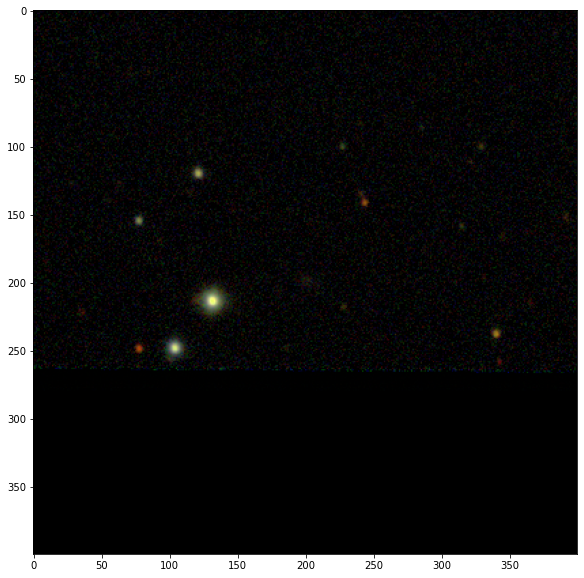

In [185]:
fig,ax = plt.subplots(figsize=(10,10))
#plt.scatter(positions[0], positions[1], marker = "s", s = 50);
plt.imshow(np.flipud(getcutout(np.flipud(data),coord2pix(data_wcs,[54.60513383,-36.89015933]), 200)));

In [98]:
size = 50
pixy = int(8725.975)
pixx = int(3140.8179)

In [62]:
import astropy.wcs as wcs
from astropy.io import fits
from astropy.coordinates import SkyCoord
from astropy import units as u
from toolz import curry

In [241]:
@curry
def coord2pix(wcs_obj,coords:iter)->tuple:
    """
    returns the pixel location given a pair RA, DEC
    """
    coords_t = SkyCoord(ra = coords[0]*u.degree, dec = coords[1]*u.degree)
    return wcs_obj.world_to_pixel(coords_t)

def getwcs(filepath:str):
    """
    returns the wcs object from a fits file
    """
    file = fits.open(filepath)
    return wcs.WCS(f[0].header)

@curry
def getcutout(wcs_obj,img:np.array,coords:iter, size:int)->np.array:
    """
    returns a cutout image centered in coords [RA,DEC]
    """
    im_coords = coord2pix(wcs_obj,coords)
    y,x = [int(coord) for coord in im_coords]
    return img[x - size:x + size,y - size:y + size]
    

In [245]:
wcs_obj = getwcs('data/fits/SPLUS-s28s34_band_R.fits')


RA, DEC = 54.3849355175621,-36.5448252522365
coord2pix(data_wcs,[RA, DEC])

(array(8733.97442481), array(3173.81798304))

In [42]:
positions = w.world_to_pixel(SkyCoord(ra = RA*u.degree, dec = DEC*u.degree))

In [51]:
positions

(array(8733.97442481), array(3173.81798304))

In [60]:
coordinates = pd.read_csv("data/LSBs_coordinates/SPLUS-s28s34.csv", usecols = ["Status","RA","DEC"])

In [56]:
coordinates.apply(coord2pix(data))

In [162]:
a = np.array([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
              [0, 0, 0, 0, 0, 0, 0, 0, 0, 1],
              [0, 7, 0, 0, 0, 2, 0, 0, 0, 1],
              [0, 2, 1, 0, 0, 0, 0, 0, 3, 0],
              [0, 0, 0, 2, 0, 2, 1, 7, 2, 0],
              [0, 8, 0, 0, 0, 0, 0, 2, 0, 0],
              [2, 0, 0, 0, 0, 2, 0, 0, 0, 0],
              [0, 0, 0, 9, 0, 0, 0, 0, 0, 5],
              [0, 6, 0, 0, 1, 0, 0, 0, 1, 5],
              [1, 0, 0, 0, 0, 0, 0, 0, 0, 0]])

In [170]:
getcutout(a,[6,5],2)

array([[0, 0, 0, 0],
       [0, 2, 1, 7],
       [0, 0, 0, 2],
       [0, 2, 0, 0]])